/usr/local/lib/python3.7/dist-packages/keras/engine/training_v1.py:2079: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


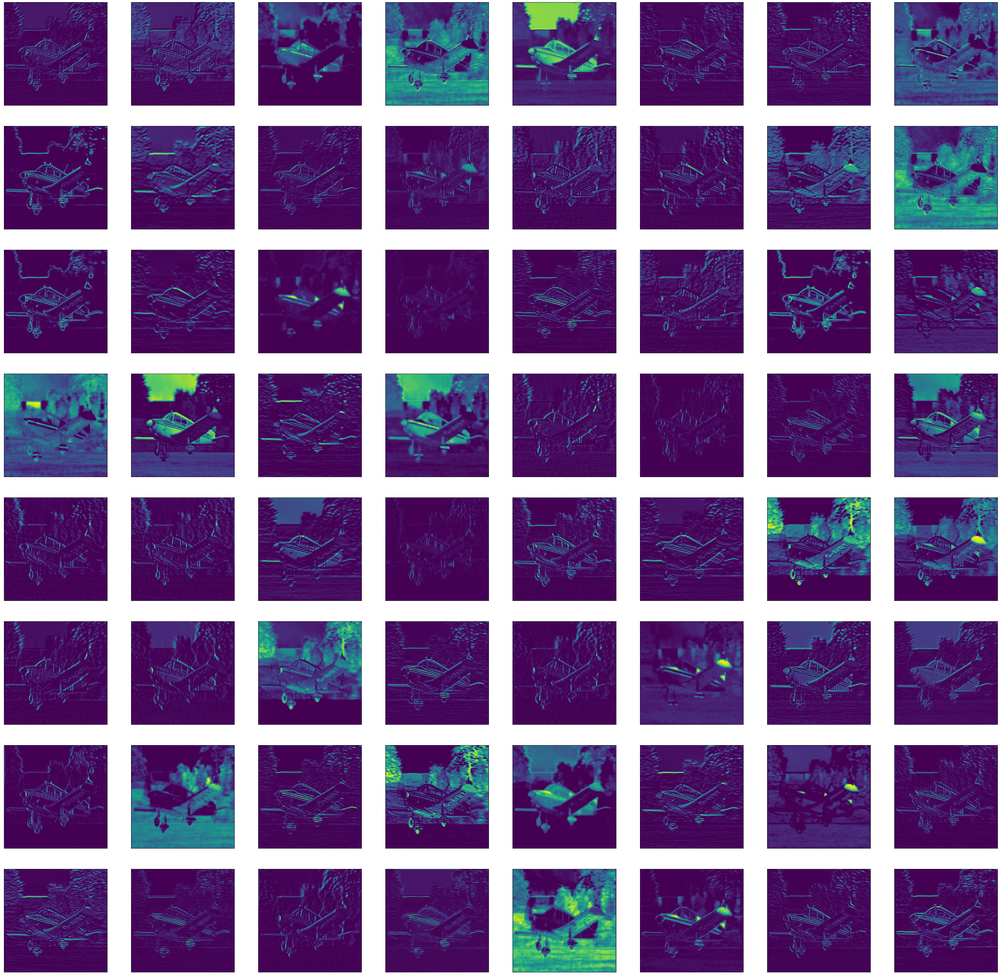

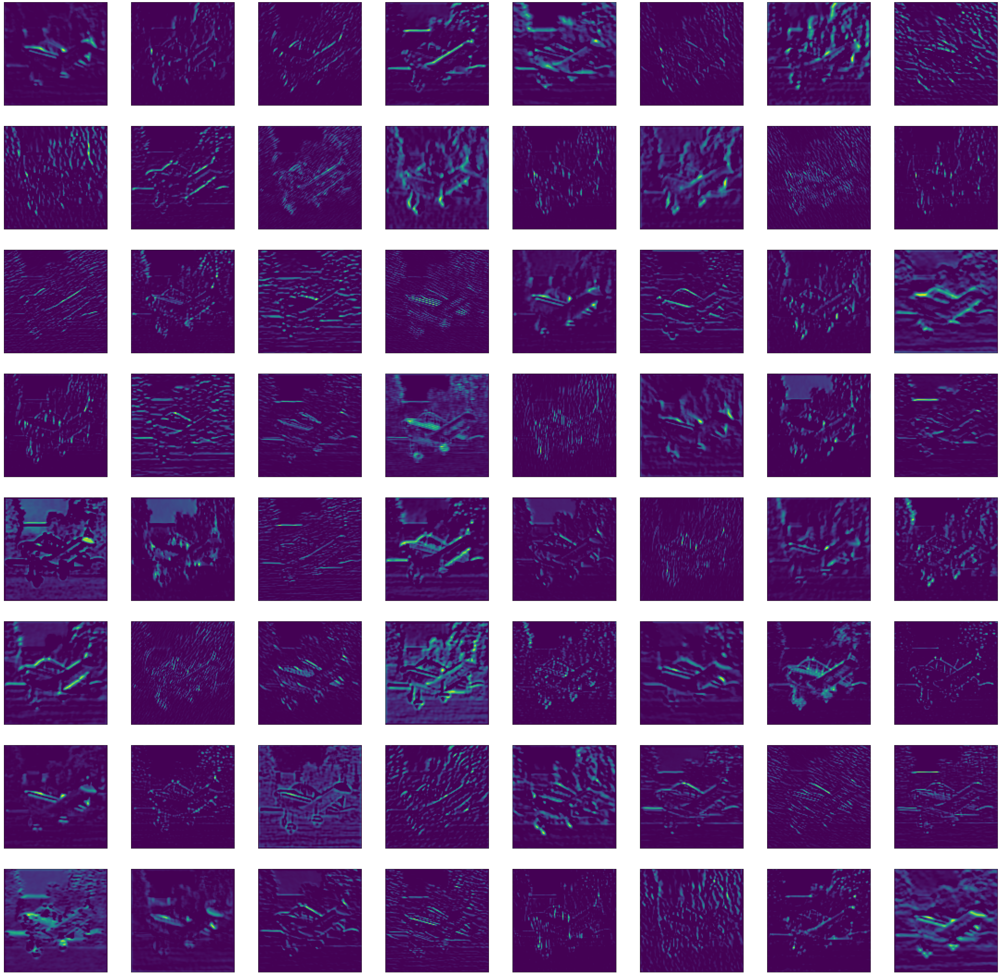

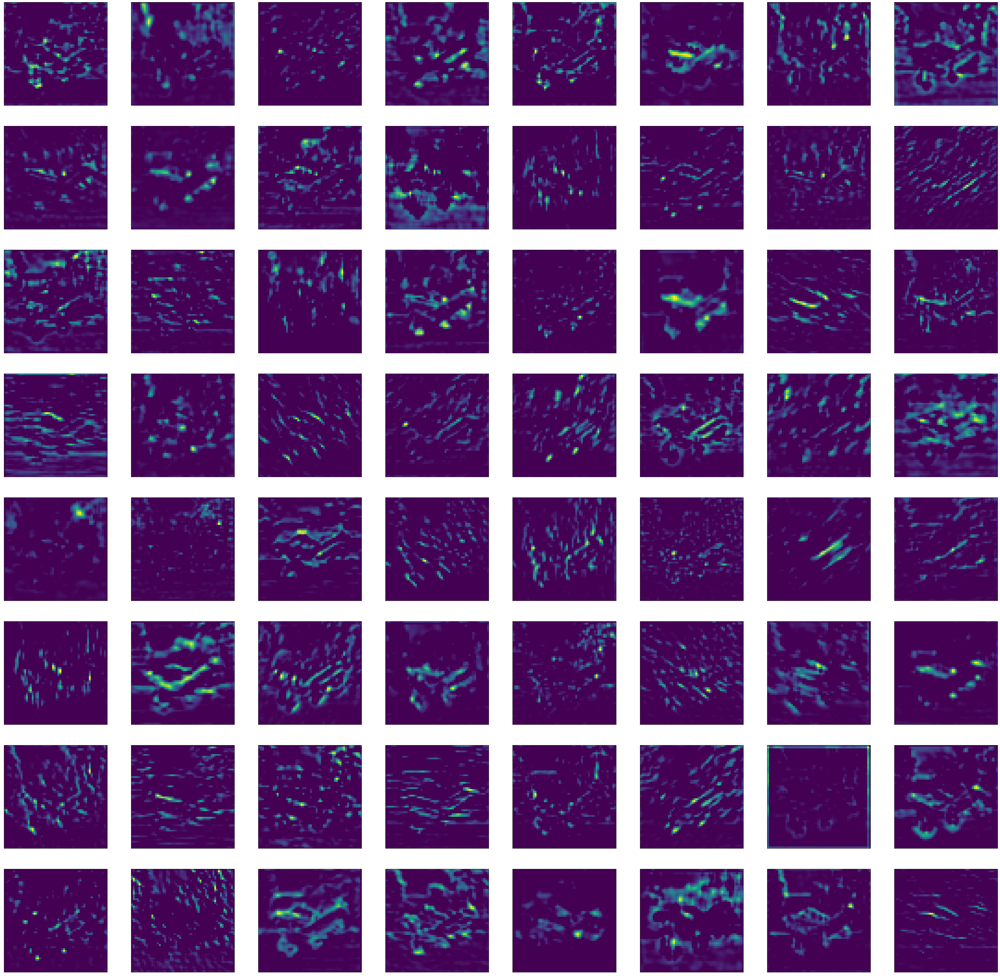

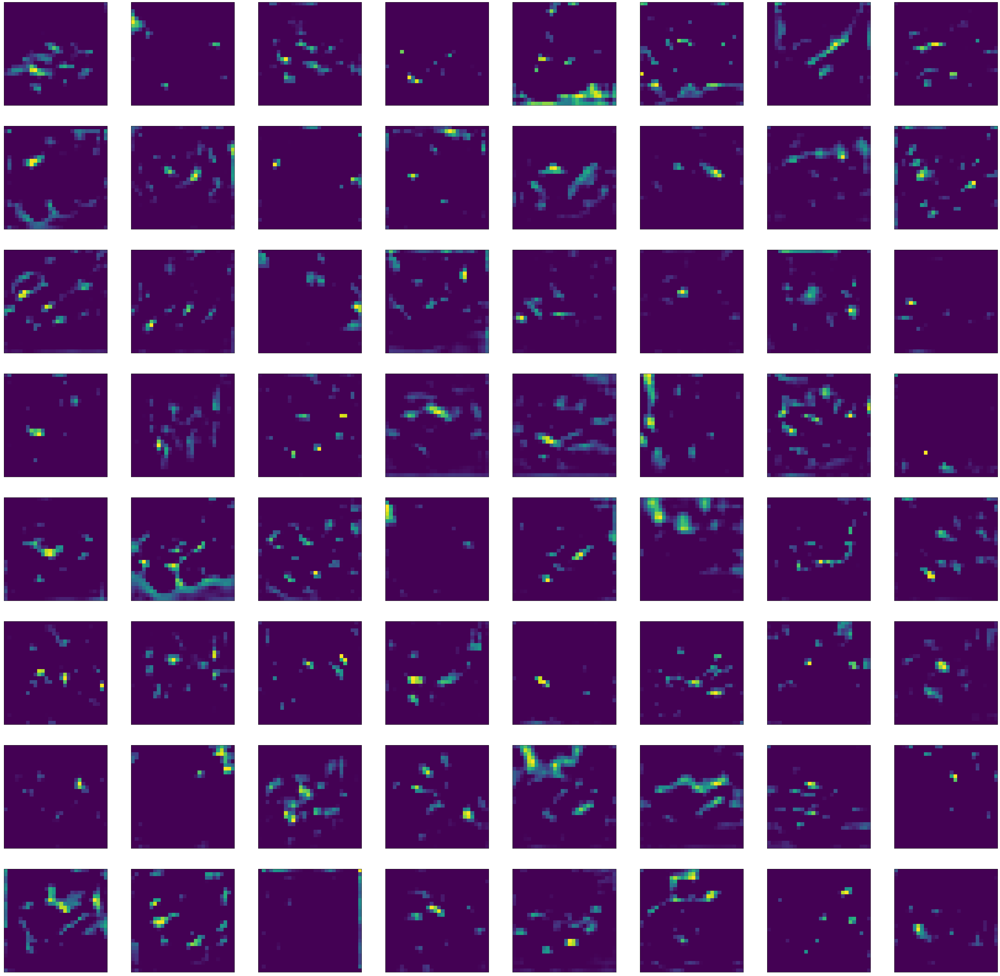

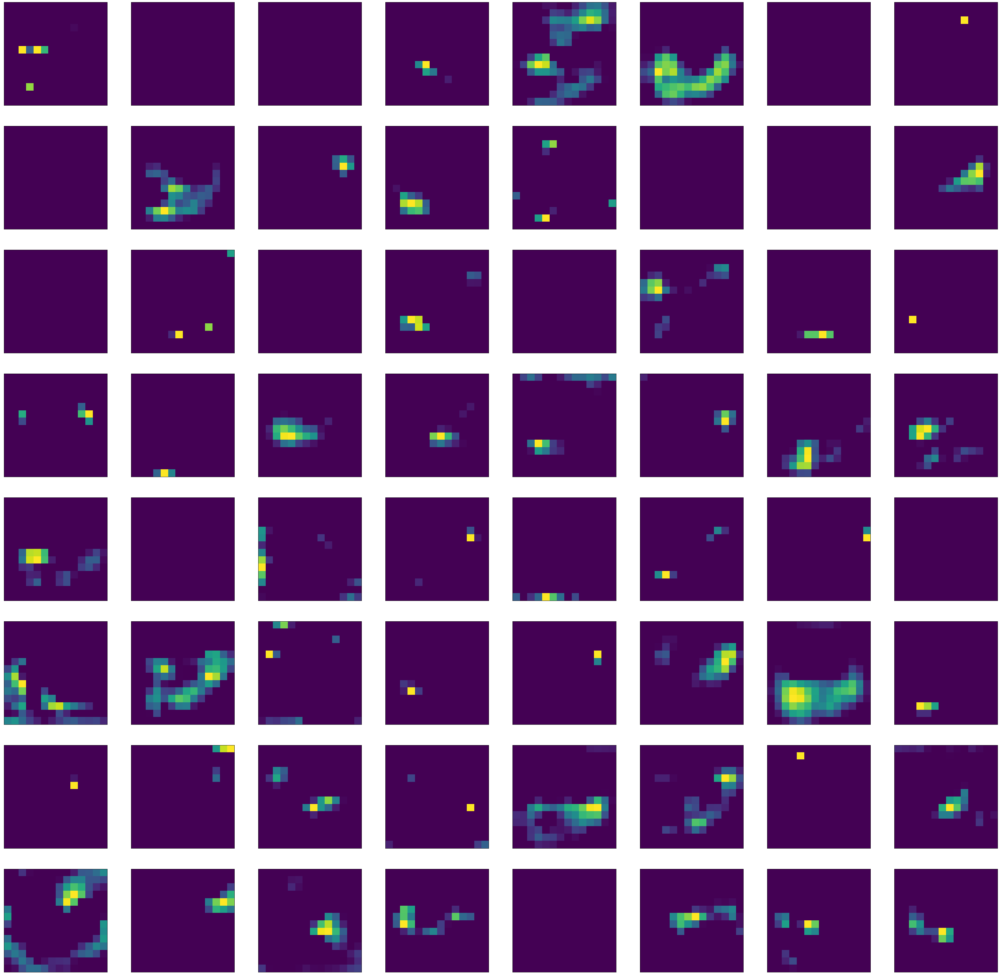

In [ ]:
# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims
pyplot.rcParams["figure.figsize"] = (50,50)
# load the model
model = VGG16()
# redefine model to output right after the first hidden layer
ixs = [2, 5, 9, 13, 17]
outputs = [model.layers[i].output for i in ixs]
model = Model(inputs=model.inputs, outputs=outputs)
# load the image with the required shape
img = load_img('plane.jpg', target_size=(224, 224))
# convert the image to an array
img = img_to_array(img)
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot the output from each block
square = 8
for fmap in feature_maps:
  # plot all 64 maps in an 8x8 squares
  ix = 1
  for _ in range(square):
    for _ in range(square):
      # specify subplot and turn of axis
      ax = pyplot.subplot(square, square, ix)
      ax.set_xticks([])
      ax.set_yticks([])
      # plot filter channel in grayscale
      pyplot.imshow(fmap[0, :, :, ix-1])
      #pyplot.imsave('cat_'+str(ix)+'.png', fmap[0, :, :, ix-1])
      ix += 1
  # show the figure
  pyplot.show()

In [ ]:
#saliency maps

from keras.applications.vgg16 import VGG16
from keras import backend as K
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input, decode_predictions

model = VGG16(weights='imagenet')

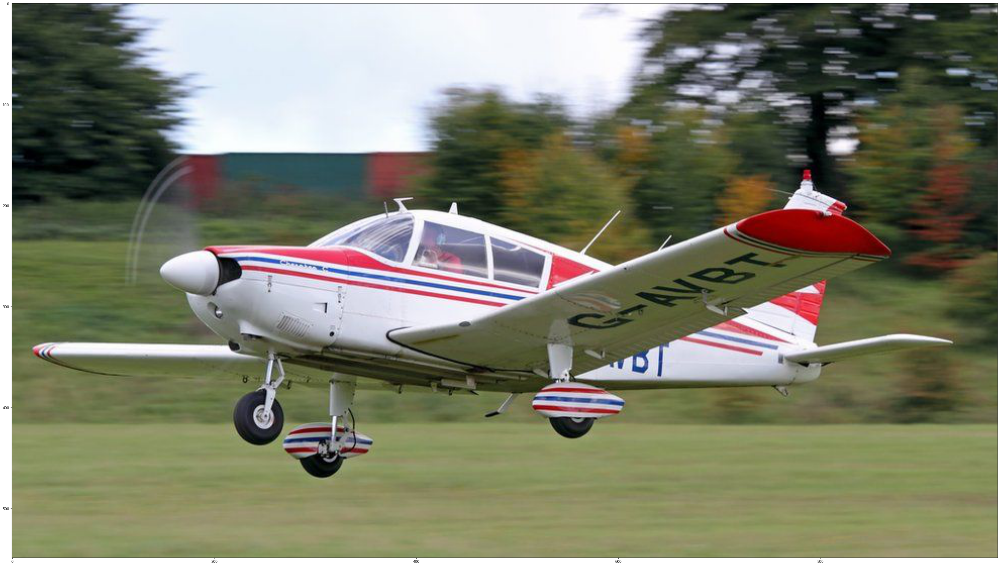

In [ ]:
img_path = 'plane.jpg'

img1 = image.load_img(img_path)
plt.imshow(img1);

img = image.load_img(img_path, target_size=(224, 224))

x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)

In [ ]:
preds = model.predict(x)
print('Predicted:', decode_predictions(preds, top=3)[0])

Predicted: [('n04592741', 'wing', 0.7250163), ('n02690373', 'airliner', 0.21387623), ('n04552348', 'warplane', 0.059770167)]


/usr/local/lib/python3.7/dist-packages/keras/engine/training_v1.py:2079: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


In [ ]:
np.argmax(preds[0])

908

In [ ]:
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
output = model.output[:, 292]
last_conv_layer = model.get_layer('block5_conv3')
# Gradients of the Tiger class wrt to the block5_conv3 filer
grads = tf.gradients(output, last_conv_layer.output)[0]

# Each entry is the mean intensity of the gradient over a specific feature-map channel 
pooled_grads = K.mean(grads, axis=(0, 1, 2))

# Accesses the values we just defined given our sample image
iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])

# Values of pooled_grads_value, conv_layer_output_value given our input image
pooled_grads_value, conv_layer_output_value = iterate([x])

# We multiply each channel in the feature-map array by the 'importance' 
# of this channel regarding the input image 
for i in range(512):
    #channel-wise mean of the resulting feature map is the Heatmap of the CAM
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

heatmap = np.mean(conv_layer_output_value, axis=-1)

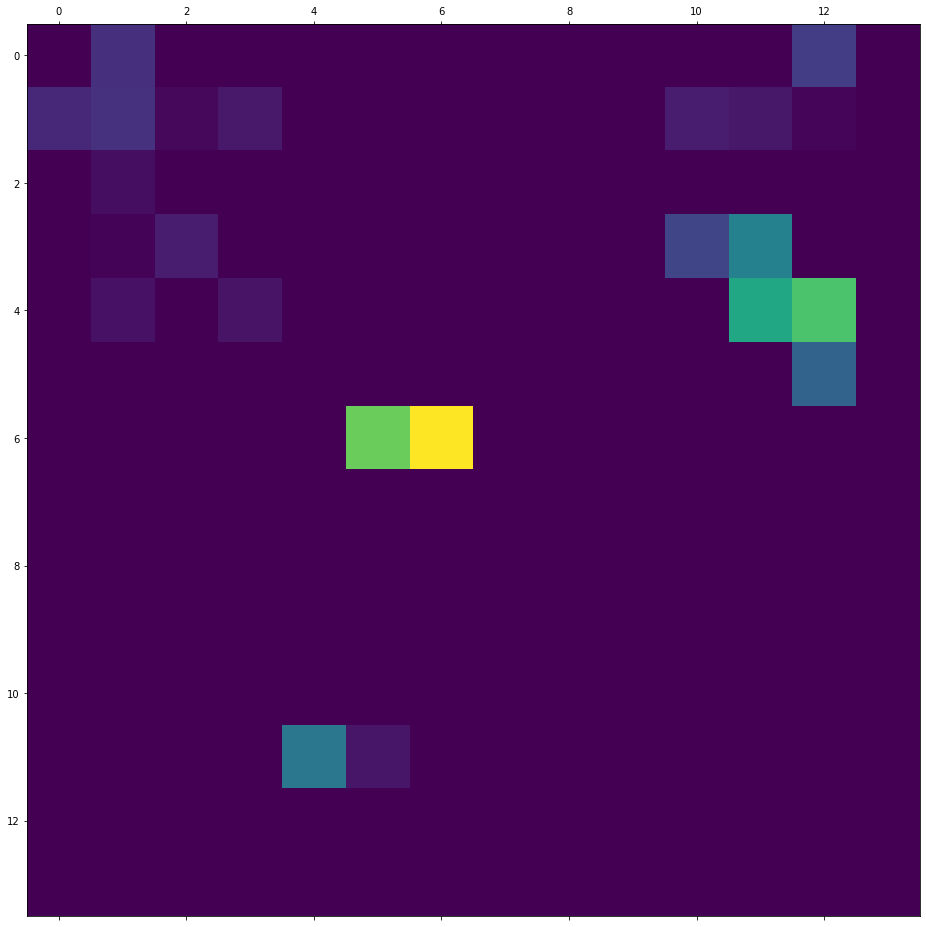

In [ ]:
heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
plt.matshow(heatmap)

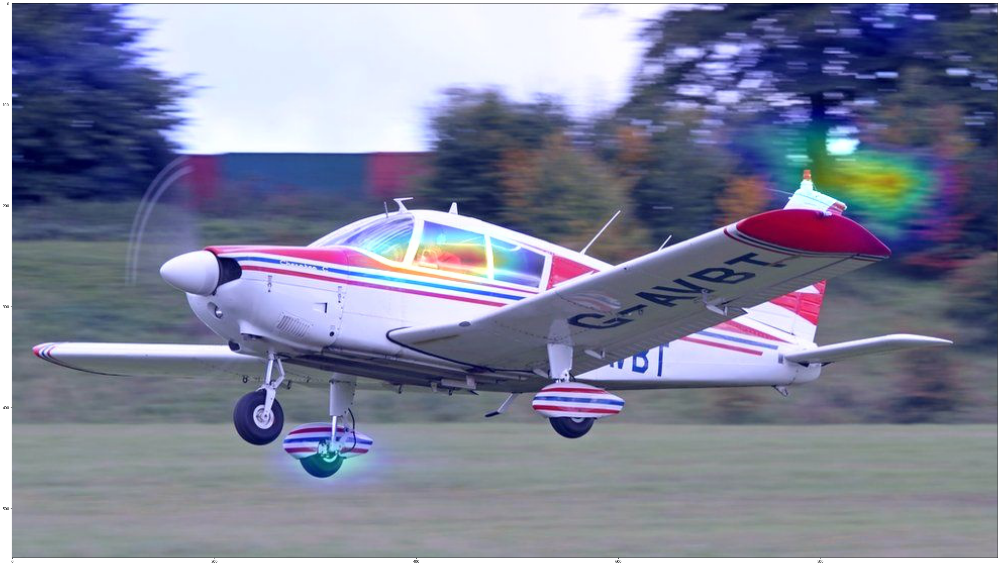

In [ ]:
import cv2

img = cv2.imread(img_path)
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

save_img_path = 'plane_cam.jpg'

cv2.imwrite(save_img_path, superimposed_img)

img1 = image.load_img(save_img_path)
plt.imshow(img1);